Original class: 605
Occluded class: 605


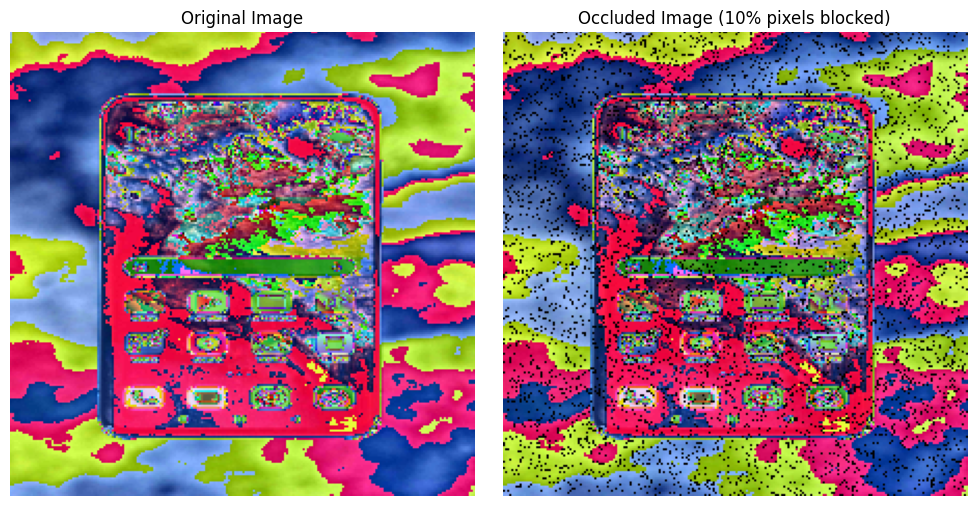

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Load the pre-trained model
model = torchvision.models.resnet50(pretrained=True)
model.eval()

# Load and preprocess the image
image_path = '/content/12.jpg'
image = Image.open(image_path)
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
input_image = preprocess(image).unsqueeze(0)

# Make a prediction on the original image
original_output = model(input_image)
original_class = torch.argmax(original_output, dim=1)

# Block 10% of the pixels
occluded_image = input_image.clone()
height, width = occluded_image.shape[2], occluded_image.shape[3]
mask = np.random.choice([0, 1], size=(height, width), p=[0.1, 0.9])
mask = np.expand_dims(mask, axis=(0, 1))
mask = torch.from_numpy(mask)
occluded_image[:, :, :, :] = occluded_image[:, :, :, :] * mask

# Predict the class on the occluded image
occluded_output = model(occluded_image)
occluded_class = torch.argmax(occluded_output, dim=1)

# Compare the predictions
print("Original class:", original_class.item())
print("Occluded class:", occluded_class.item())

# Convert tensors to PIL images
original_image = transforms.ToPILImage()(input_image.squeeze())
occluded_image = transforms.ToPILImage()(occluded_image.squeeze())

# Create a figure and plot the images
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Image")
axes[0].axis('off')
axes[1].imshow(occluded_image)
axes[1].set_title("Occluded Image (10% pixels blocked)")
axes[1].axis('off')

# Show the figure
plt.tight_layout()
plt.show()


Original class: 605
Occluded class: 605


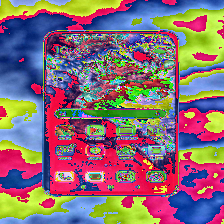

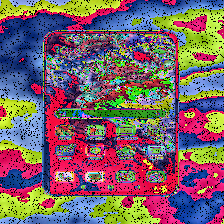

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
from PIL import Image
import numpy as np

# Load the pre-trained model
model = torchvision.models.resnet50(pretrained=True)
model.eval()

# Load and preprocess the image
image_path = '/content/12.jpg'
image = Image.open(image_path)
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
input_image = preprocess(image).unsqueeze(0)

# Make a prediction on the original image
original_output = model(input_image)
original_class = torch.argmax(original_output, dim=1)

# Calculate the number of pixels to be blocked
num_pixels = int(input_image.size(2) * input_image.size(3) * 0.1)

# Randomly select the indices of pixels to be blocked
indices = np.random.choice(input_image.size(2) * input_image.size(3), num_pixels, replace=False)
indices = np.unravel_index(indices, (input_image.size(2), input_image.size(3)))

# Occlude the desired pixels
occluded_image = input_image.clone()
occluded_image[:, :, indices[0], indices[1]] = 0  # Set the pixel values to zero

# Predict the class on the occluded image
occluded_output = model(occluded_image)
occluded_class = torch.argmax(occluded_output, dim=1)

# Compare the predictions
print("Original class:", original_class.item())
print("Occluded class:", occluded_class.item())

# Convert tensors to PIL images
original_image = transforms.ToPILImage()(input_image.squeeze())
occluded_image = transforms.ToPILImage()(occluded_image.squeeze())

# Show the original and occluded images
original_image.show()
occluded_image.show()


In [ ]:
!wget https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json -O imagenet_classes.txt


--2023-06-09 09:20:09--  https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14193 (14K) [text/plain]
Saving to: ‘imagenet_classes.txt’

imagenet_classes.tx 100%[===================>]  13.86K  --.-KB/s    in 0s      

2023-06-09 09:20:10 (114 MB/s) - ‘imagenet_classes.txt’ saved [14193/14193]



Original class: "iPod",
Masked class: "iPod",


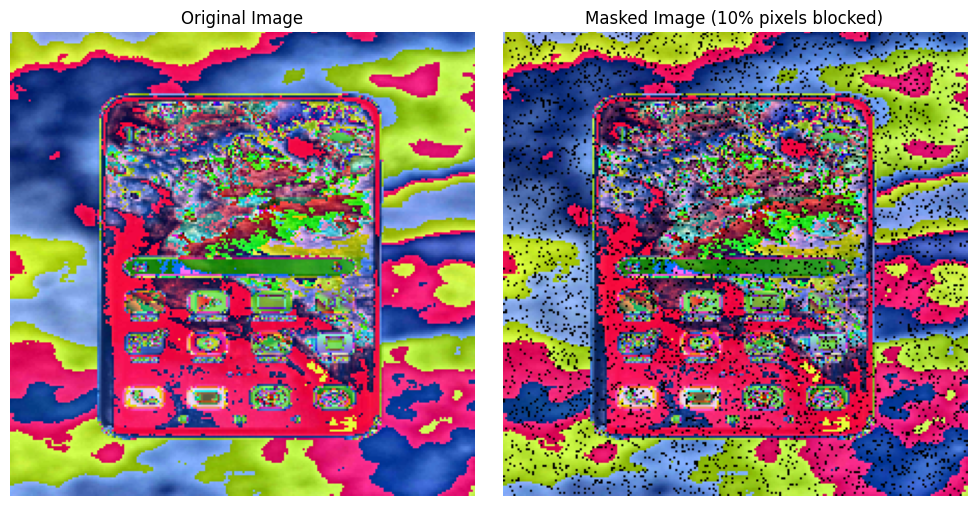

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Load the pre-trained model
model = torchvision.models.resnet50(pretrained=True)
model.eval()

# Load and preprocess the image
image_path = '/content/12.jpg'
image = Image.open(image_path)
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
input_image = preprocess(image).unsqueeze(0)

# Make a prediction on the original image
original_output = model(input_image)
original_class = torch.argmax(original_output, dim=1)

# Calculate the number of pixels to block
total_pixels = input_image.size(2) * input_image.size(3)
pixels_to_block = int(0.1 * total_pixels)

# Create a binary mask to block the pixels
mask = torch.ones_like(input_image)
mask_pixels = np.random.choice(total_pixels, size=pixels_to_block, replace=False)
mask[:, :, mask_pixels // input_image.size(3), mask_pixels % input_image.size(3)] = 0

# Apply the mask to the original image
masked_image = input_image * mask

# Predict the class on the masked image
masked_output = model(masked_image)
masked_class = torch.argmax(masked_output, dim=1)

# Get the class names from the ImageNet dataset
with open('imagenet_classes.txt') as f:
    class_names = [line.strip() for line in f.readlines()]

# Print the original class name and masked class name
print("Original class:", class_names[original_class.item()])
print("Masked class:", class_names[masked_class.item()])

# Convert tensors to PIL images
original_image = transforms.ToPILImage()(input_image.squeeze())
masked_image = transforms.ToPILImage()(masked_image.squeeze())

# Create a figure and plot the images
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Image")
axes[0].axis('off')
axes[1].imshow(masked_image)
axes[1].set_title("Masked Image (10% pixels blocked)")
axes[1].axis('off')

# Show the figure
plt.tight_layout()
plt.show()


In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data_dir = '/content/drive/MyDrive/dataset1'


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

## ***Without blockig the pixels***

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import random

# Define the CNN architecture
class CNN(nn.Module):
    def __init__(self, num_classes):
        super(CNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.classifier = nn.Linear(32 * 56 * 56, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

# Set device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define data transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define dataset paths
train_data_path = '/content/drive/MyDrive/dataset1/seg_train'
test_data_path = '/content/drive/MyDrive/dataset1/seg_test'

# Load the training dataset
train_dataset = ImageFolder(train_data_path, transform=transform)

# Use only a subset of 2000 images
random.seed(123)
subset_indices = random.sample(range(len(train_dataset)), k=2000)
train_subset = torch.utils.data.Subset(train_dataset, subset_indices)

train_loader = DataLoader(train_subset, batch_size=64, shuffle=True)

# Load the testing dataset
test_dataset = ImageFolder(test_data_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Create an instance of the CNN model
num_classes = len(train_dataset.classes)
model = CNN(num_classes).to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
train_loss_history = []
test_accuracy_history = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    train_loss = running_loss / len(train_loader)
    train_loss_history.append(train_loss)

    # Evaluation
    model.eval()
    with torch.no_grad():
        correct = 0
        total = 0
        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)

            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        test_accuracy = 100 * correct / total
        test_accuracy_history.append(test_accuracy)

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {train_loss}, Test Accuracy: {test_accuracy}%")


Epoch [1/10], Loss: 2.021087385714054, Test Accuracy: 52.2%
Epoch [2/10], Loss: 1.0534609351307154, Test Accuracy: 58.0%
Epoch [3/10], Loss: 0.7914479319006205, Test Accuracy: 61.833333333333336%
Epoch [4/10], Loss: 0.5880006588995457, Test Accuracy: 66.13333333333334%
Epoch [5/10], Loss: 0.4092432549223304, Test Accuracy: 65.5%
Epoch [6/10], Loss: 0.2780923726968467, Test Accuracy: 64.96666666666667%
Epoch [7/10], Loss: 0.1861820719204843, Test Accuracy: 64.16666666666667%
Epoch [8/10], Loss: 0.11547299276571721, Test Accuracy: 65.8%
Epoch [9/10], Loss: 0.074921615421772, Test Accuracy: 65.46666666666667%
Epoch [10/10], Loss: 0.04391388484509662, Test Accuracy: 64.56666666666666%


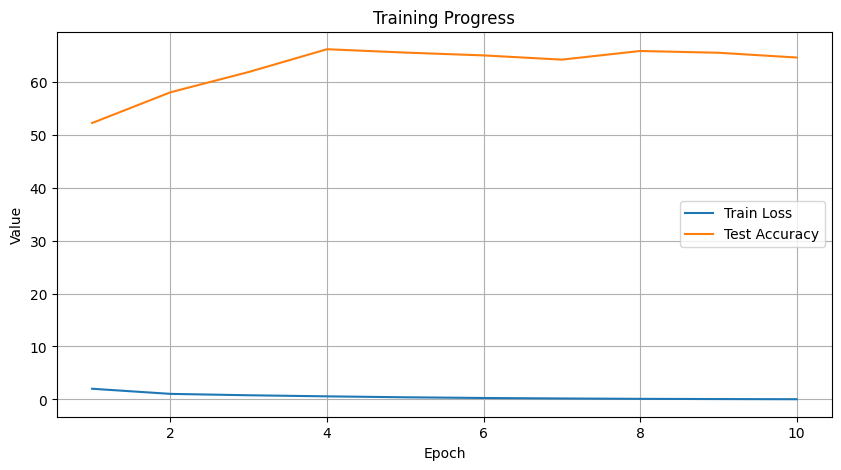

In [ ]:
# Plot loss and accuracy graphs
plt.figure(figsize=(10, 5))
plt.plot(range(1, num_epochs + 1), train_loss_history, label='Train Loss')
plt.plot(range(1, num_epochs + 1), test_accuracy_history, label='Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Value')
plt.title('Training Progress')
plt.legend()
plt.grid(True)
plt.show()

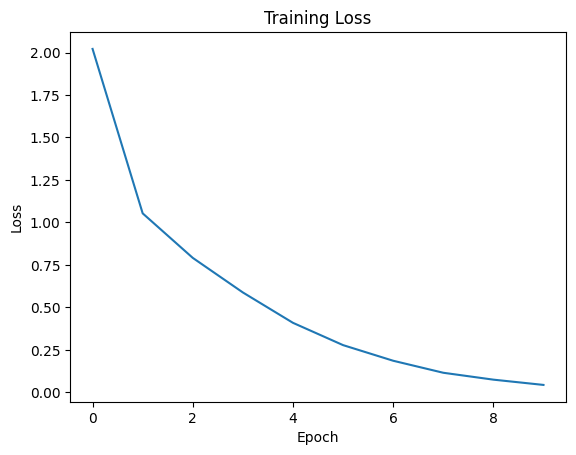

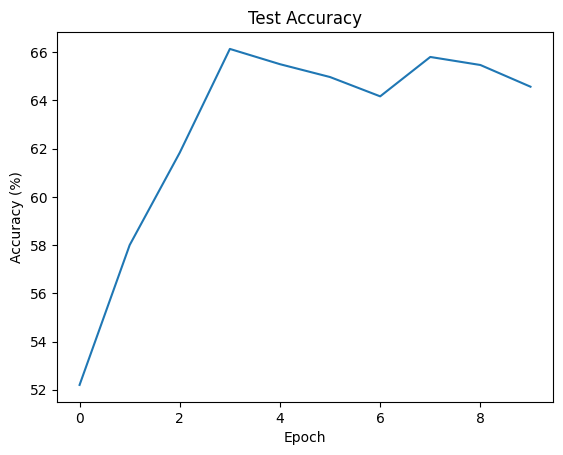

In [ ]:
# Plot the training loss history
plt.plot(train_loss_history)
plt.title("Training Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.show()

# Plot the test accuracy history
plt.plot(test_accuracy_history)
plt.title("Test Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.show()

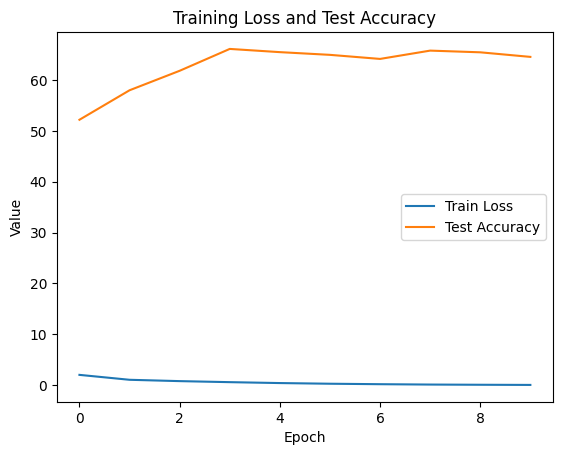

In [ ]:
import matplotlib.pyplot as plt

# Plot the training loss and test accuracy history
plt.plot(train_loss_history, label='Train Loss')
plt.plot(test_accuracy_history, label='Test Accuracy')
plt.title("Training Loss and Test Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Value")
plt.legend()
plt.show()


In [ ]:
import os

# Define the path to the folder in Google Drive
drive_folder = '/content/drive/MyDrive/Mask Model'
os.makedirs(drive_folder, exist_ok=True)

# Save the model to the specified path
model_path = os.path.join(drive_folder, 'mask.pt')
torch.save(model.state_dict(), model_path)

print("Model saved successfully.")


Model saved successfully.


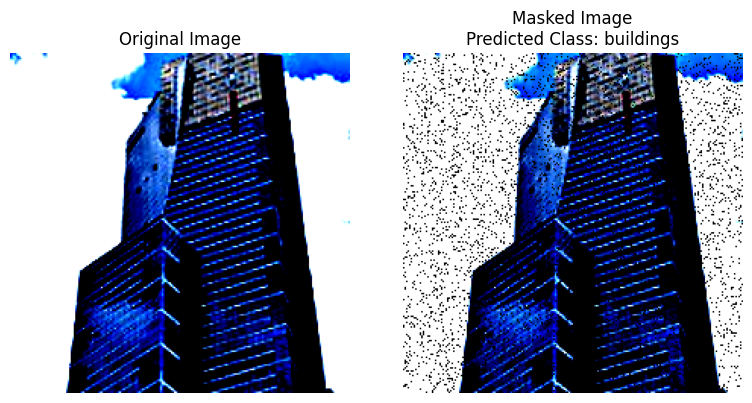

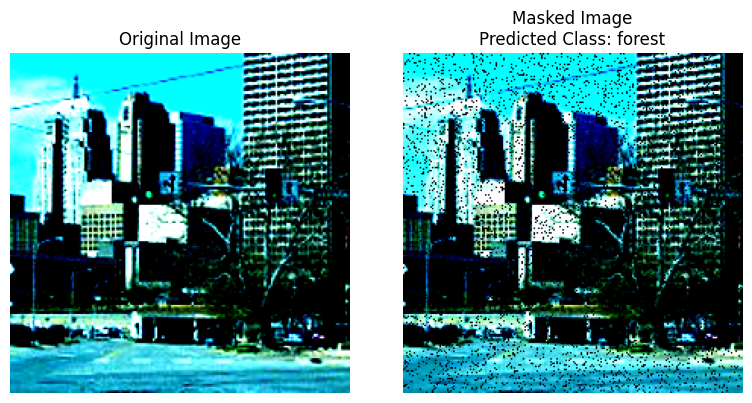

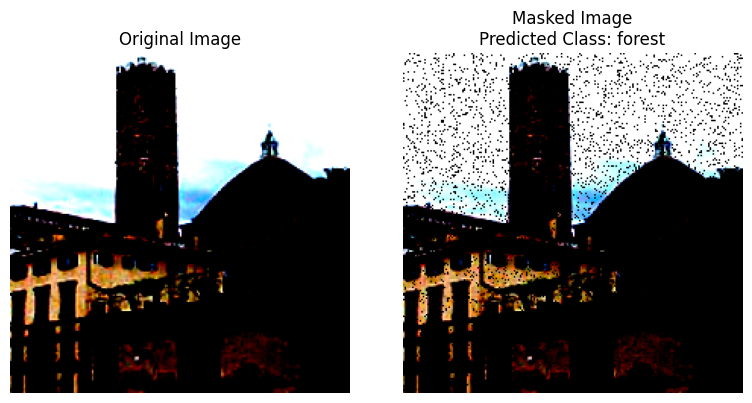

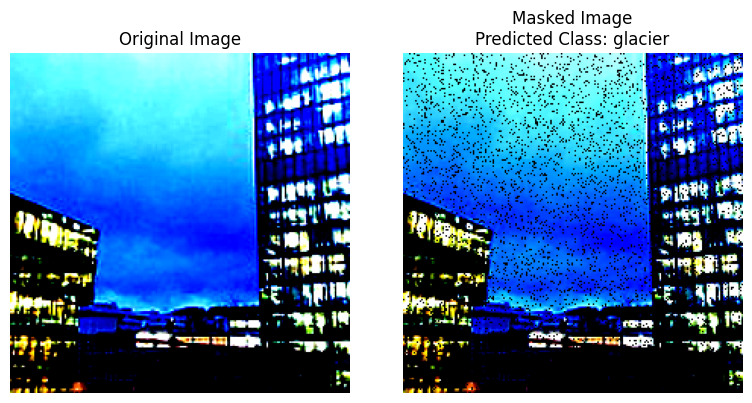

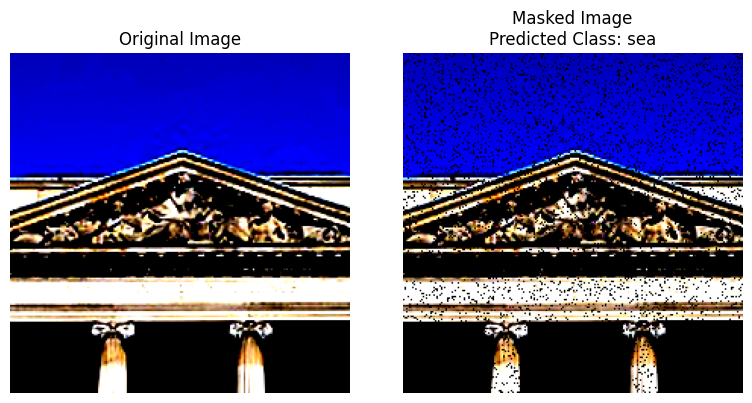

...

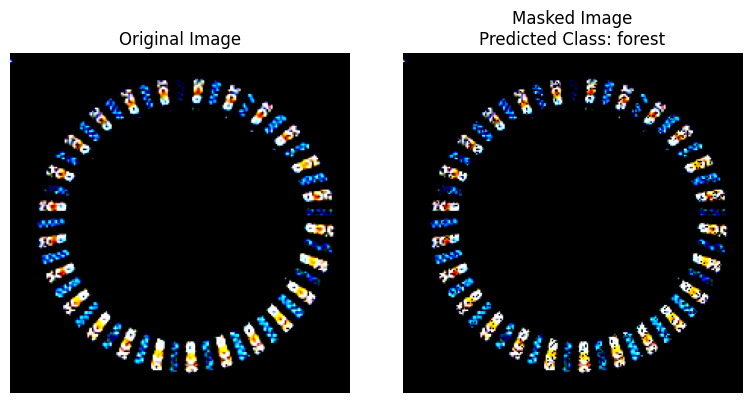

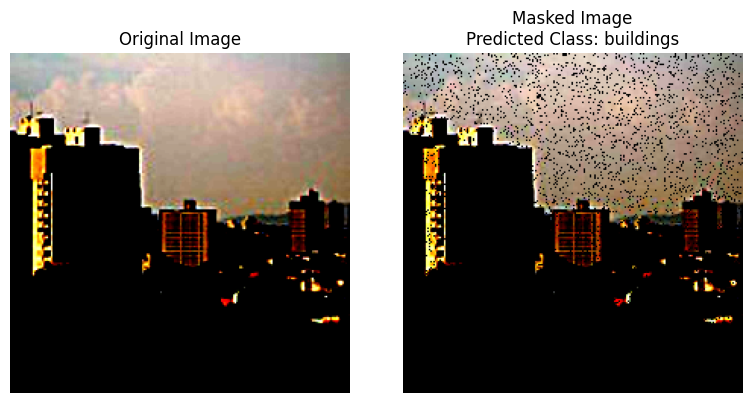

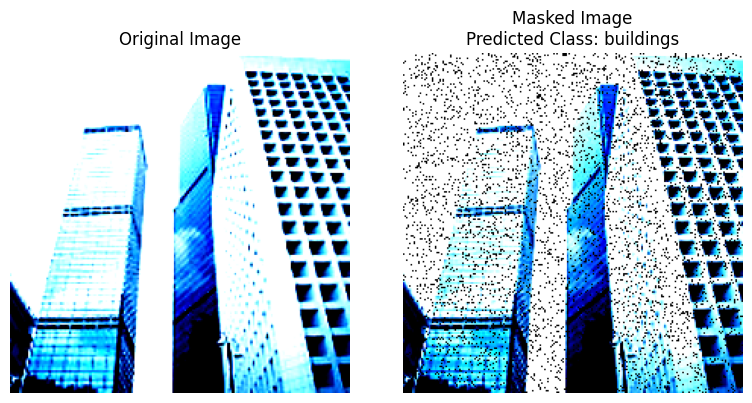

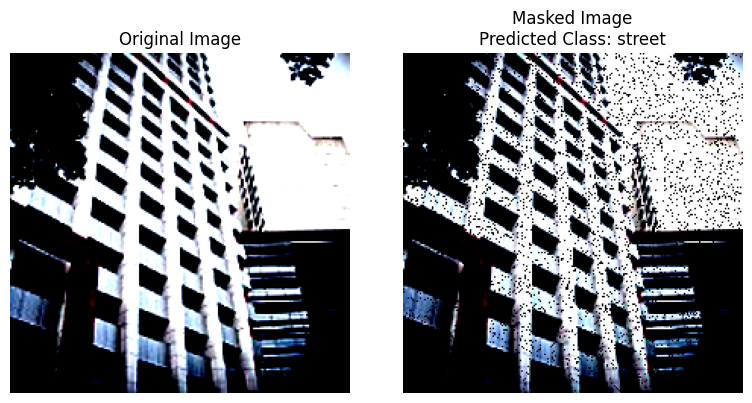

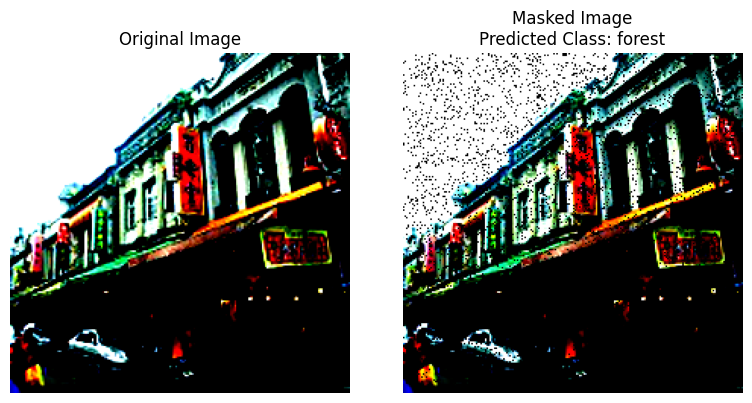

In [ ]:
#For Masking
with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        # Mask the images by blocking 10% of the pixels
        total_pixels = images.size(2) * images.size(3)
        pixels_to_block = int(0.1 * total_pixels)

        mask = torch.ones_like(images)
        mask_pixels = np.random.choice(total_pixels, size=pixels_to_block, replace=False)
        mask[:, :, mask_pixels // images.size(3), mask_pixels % images.size(3)] = 0

        masked_images = images * mask

        # Predict the class on the masked images
        masked_outputs = model(masked_images)
        _, masked_predicted = torch.max(masked_outputs.data, 1)

        # Convert tensors to numpy arrays
        images_np = images.cpu().numpy()
        masked_images_np = masked_images.cpu().numpy()

        # Plot the original and masked images
        for i in range(images_np.shape[0]):
            original_image = np.transpose(images_np[i], (1, 2, 0))
            masked_image = np.transpose(masked_images_np[i], (1, 2, 0))

            plt.figure(figsize=(8, 4))
            plt.subplot(1, 2, 1)
            plt.imshow(original_image)
            plt.title("Original Image")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(masked_image)
            plt.title(f"Masked Image\nPredicted Class: {test_dataset.classes[masked_predicted[i]]}")
            plt.axis('off')

            plt.tight_layout()
            plt.show()

## ***Block 5% of the pixels in each image and then Train***

Epoch [1/10], Loss: 4.3502, Accuracy: 30.75%, Test Loss: 1.6739, Test Accuracy: 35.83%
Epoch [2/10], Loss: 1.4787, Accuracy: 40.15%, Test Loss: 1.3440, Test Accuracy: 46.43%
Epoch [3/10], Loss: 1.1632, Accuracy: 54.20%, Test Loss: 1.2039, Test Accuracy: 55.63%
Epoch [4/10], Loss: 0.9512, Accuracy: 65.65%, Test Loss: 1.0993, Test Accuracy: 59.67%
Epoch [5/10], Loss: 0.8146, Accuracy: 69.40%, Test Loss: 1.0703, Test Accuracy: 59.00%
Epoch [6/10], Loss: 0.7024, Accuracy: 75.95%, Test Loss: 1.0375, Test Accuracy: 61.27%
Epoch [7/10], Loss: 0.6008, Accuracy: 80.40%, Test Loss: 1.0292, Test Accuracy: 61.70%
Epoch [8/10], Loss: 0.4660, Accuracy: 85.75%, Test Loss: 1.0745, Test Accuracy: 60.03%
Epoch [9/10], Loss: 0.3882, Accuracy: 89.10%, Test Loss: 1.1252, Test Accuracy: 59.80%
Epoch [10/10], Loss: 0.3090, Accuracy: 91.60%, Test Loss: 1.1594, Test Accuracy: 60.03%


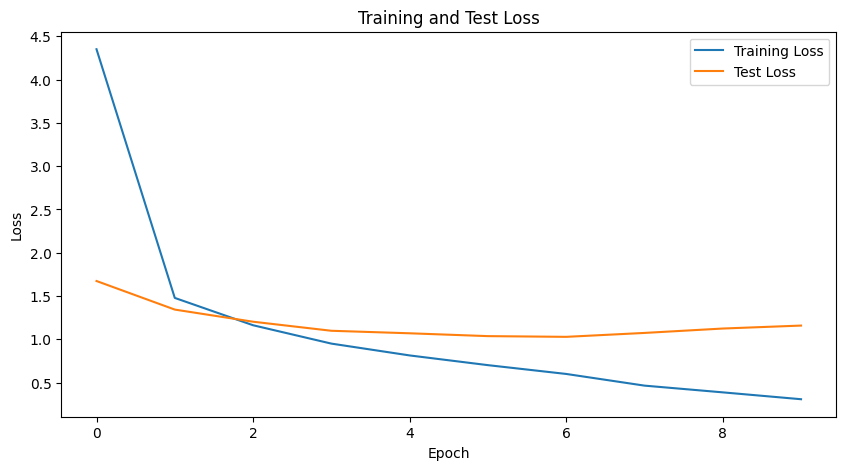

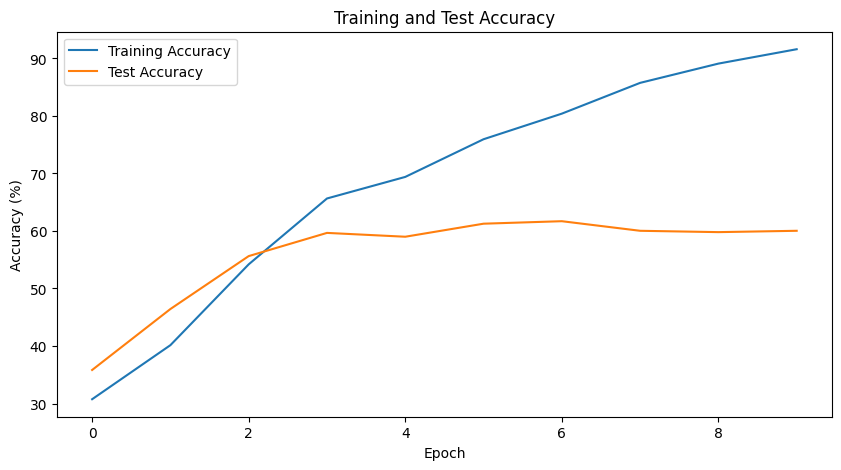

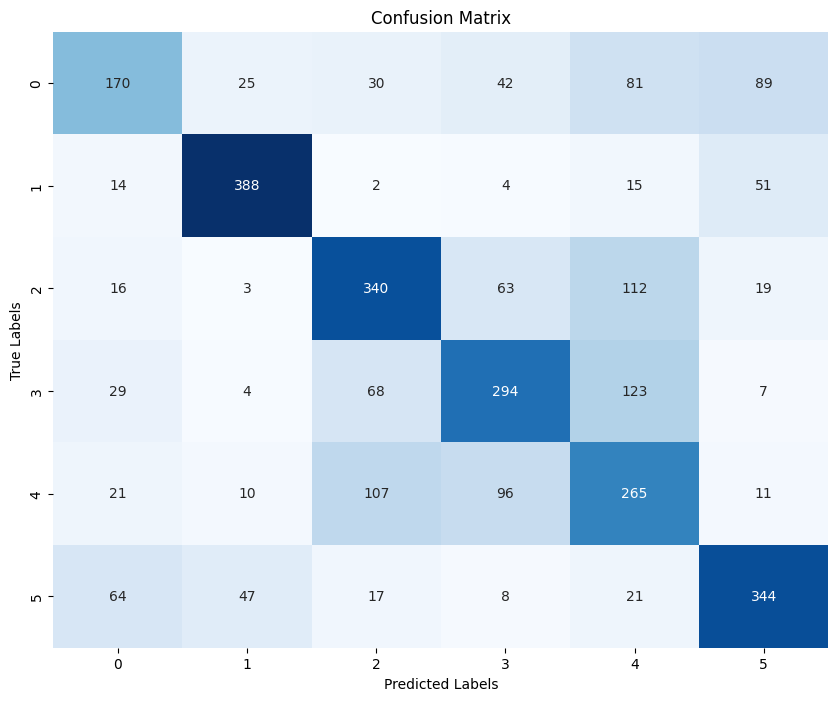

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Function to block a percentage of pixels in an image
def block_pixels(image, percentage):
    # Calculate the number of pixels to block
    num_pixels = int(image.size(1) * image.size(2) * percentage)

    # Generate random indices to block
    indices = random.sample(range(image.size(1) * image.size(2)), num_pixels)
    indices = torch.tensor(indices)

    # Set the blocked pixels to zero
    image[:, indices // image.size(2), indices % image.size(2)] = 0

    return image

# Define the CNN architecture
class CNN(nn.Module):
    def __init__(self, num_classes):
        super(CNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.classifier = nn.Linear(32 * 56 * 56, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

# Set device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define data transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define dataset paths
train_data_path = '/content/drive/MyDrive/dataset1/seg_train'
test_data_path = '/content/drive/MyDrive/dataset1/seg_test'

# Load the training dataset
train_dataset = ImageFolder(train_data_path, transform=transform)

# Use only a subset of 2000 images
random.seed(123)
subset_indices = random.sample(range(len(train_dataset)), k=2000)
train_subset = torch.utils.data.Subset(train_dataset, subset_indices)

train_loader = DataLoader(train_subset, batch_size=64, shuffle=True)

# Load the testing dataset
test_dataset = ImageFolder(test_data_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Create an instance of the CNN model
num_classes = len(train_dataset.classes)
model = CNN(num_classes).to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
train_loss_history = []
test_loss_history = []
train_accuracy_history = []
test_accuracy_history = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # Block 5% of the pixels in each image
        for i in range(images.size(0)):
            images[i] = block_pixels(images[i].clone(), 0.05)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_accuracy = 100 * correct / total

    # Evaluation
    model.eval()
    with torch.no_grad():
        test_running_loss = 0.0
        test_correct = 0
        test_total = 0

        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            test_running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            test_total += labels.size(0)
            test_correct += (predicted == labels).sum().item()

        test_loss = test_running_loss / len(test_loader)
        test_accuracy = 100 * test_correct / test_total

    train_loss_history.append(train_loss)
    test_loss_history.append(test_loss)
    train_accuracy_history.append(train_accuracy)
    test_accuracy_history.append(test_accuracy)

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {train_loss:.4f}, Accuracy: {train_accuracy:.2f}%, Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%")

# Plotting the training and test loss
plt.figure(figsize=(10, 5))
plt.plot(train_loss_history, label='Training Loss')
plt.plot(test_loss_history, label='Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Test Loss')
plt.legend()
plt.show()

# Plotting the training and test accuracy
plt.figure(figsize=(10, 5))
plt.plot(train_accuracy_history, label='Training Accuracy')
plt.plot(test_accuracy_history, label='Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Training and Test Accuracy')
plt.legend()
plt.show()

# Calculate the confusion matrix
model.eval()
all_labels = []
all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert the lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Create the confusion matrix
cm = confusion_matrix(all_labels, all_predictions)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', cbar=False)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()


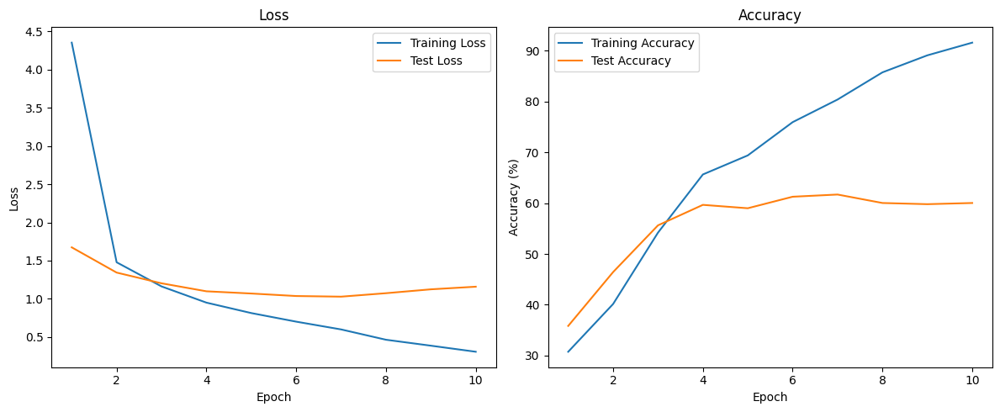

In [ ]:
# Plotting the loss and accuracy graphs
epochs = np.arange(1, num_epochs+1)

# Plot the training and test loss
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss_history, label='Training Loss')
plt.plot(epochs, test_loss_history, label='Test Loss')
plt.title("Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

# Plot the training and test accuracy
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy_history, label='Training Accuracy')
plt.plot(epochs, test_accuracy_history, label='Test Accuracy')
plt.title("Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.legend()

plt.tight_layout()
plt.show()

## ***Block 10% of the pixels in each image and then Train***

Epoch [1/10], Loss: 2.7605, Accuracy: 37.60%, Test Loss: 1.4658, Test Accuracy: 53.43%
Epoch [2/10], Loss: 1.1579, Accuracy: 58.95%, Test Loss: 1.0989, Test Accuracy: 57.10%
Epoch [3/10], Loss: 0.8910, Accuracy: 68.85%, Test Loss: 1.0097, Test Accuracy: 60.97%
Epoch [4/10], Loss: 0.6398, Accuracy: 79.40%, Test Loss: 0.9402, Test Accuracy: 65.17%
Epoch [5/10], Loss: 0.4859, Accuracy: 85.65%, Test Loss: 0.9887, Test Accuracy: 62.77%
Epoch [6/10], Loss: 0.3008, Accuracy: 92.15%, Test Loss: 1.1100, Test Accuracy: 62.10%
Epoch [7/10], Loss: 0.1748, Accuracy: 96.20%, Test Loss: 1.1026, Test Accuracy: 64.33%
Epoch [8/10], Loss: 0.1175, Accuracy: 97.35%, Test Loss: 1.3329, Test Accuracy: 60.07%
Epoch [9/10], Loss: 0.0799, Accuracy: 98.60%, Test Loss: 1.3443, Test Accuracy: 61.10%
Epoch [10/10], Loss: 0.0489, Accuracy: 99.60%, Test Loss: 1.2859, Test Accuracy: 62.83%


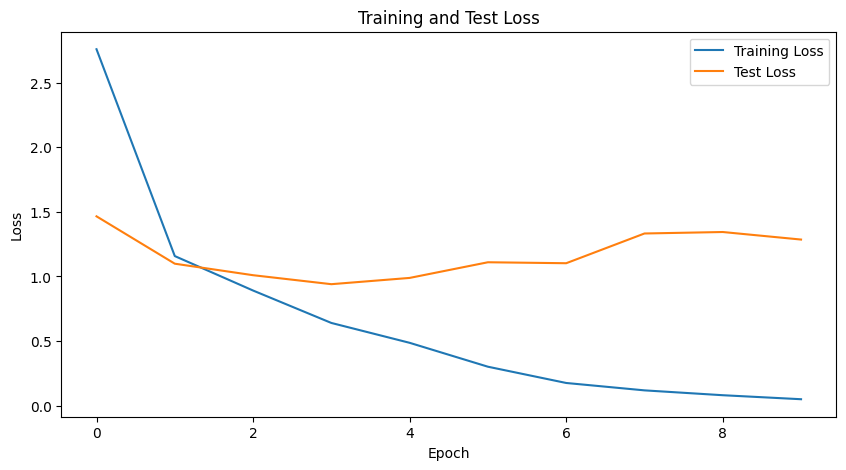

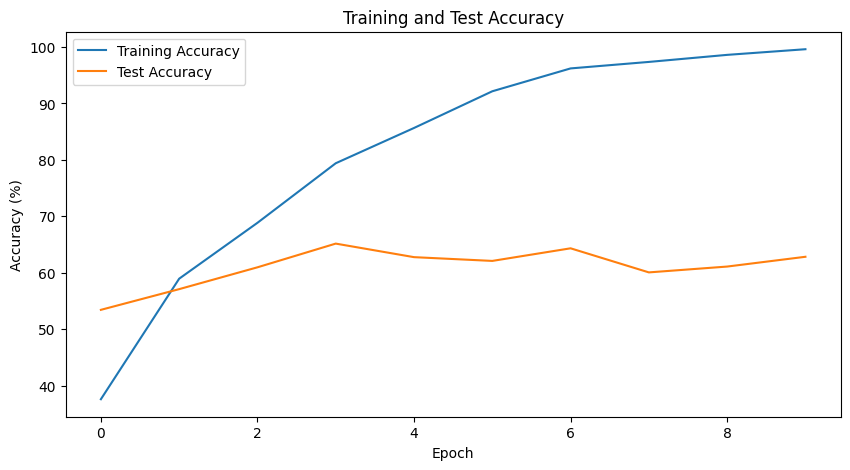

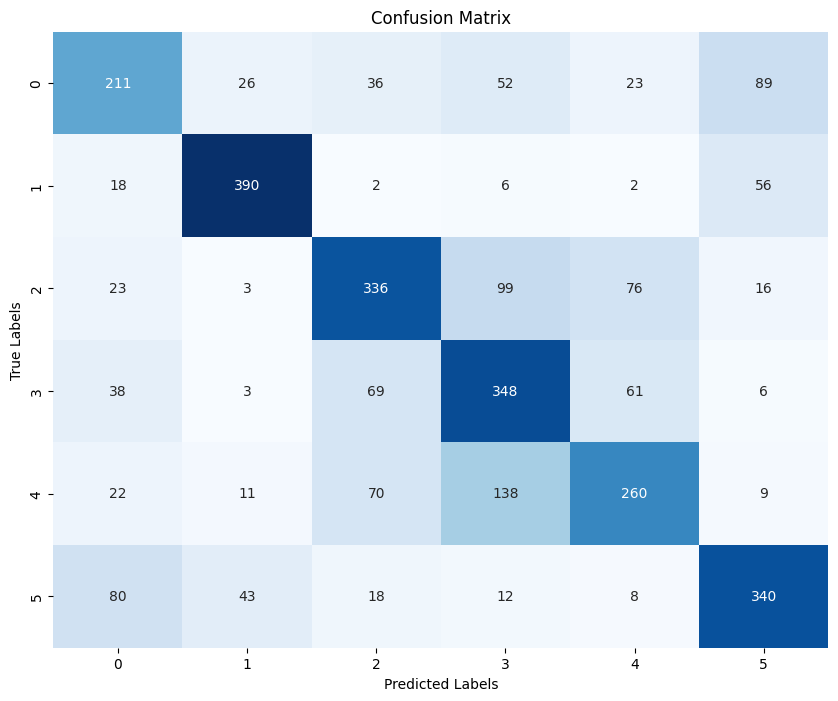

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Function to block a percentage of pixels in an image
def block_pixels(image, percentage):
    # Calculate the number of pixels to block
    num_pixels = int(image.size(1) * image.size(2) * percentage)

    # Generate random indices to block
    indices = random.sample(range(image.size(1) * image.size(2)), num_pixels)
    indices = torch.tensor(indices)

    # Set the blocked pixels to zero
    image[:, indices // image.size(2), indices % image.size(2)] = 0

    return image

# Define the CNN architecture
class CNN(nn.Module):
    def __init__(self, num_classes):
        super(CNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.classifier = nn.Linear(32 * 56 * 56, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

# Set device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define data transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define dataset paths
train_data_path = '/content/drive/MyDrive/dataset1/seg_train'
test_data_path = '/content/drive/MyDrive/dataset1/seg_test'

# Load the training dataset
train_dataset = ImageFolder(train_data_path, transform=transform)

# Use only a subset of 2000 images
random.seed(123)
subset_indices = random.sample(range(len(train_dataset)), k=2000)
train_subset = torch.utils.data.Subset(train_dataset, subset_indices)

train_loader = DataLoader(train_subset, batch_size=64, shuffle=True)

# Load the testing dataset
test_dataset = ImageFolder(test_data_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Create an instance of the CNN model
num_classes = len(train_dataset.classes)
model = CNN(num_classes).to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
train_loss_history = []
test_loss_history = []
train_accuracy_history = []
test_accuracy_history = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # Block 10% of the pixels in each image
        for i in range(images.size(0)):
            images[i] = block_pixels(images[i].clone(), 0.1)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_accuracy = 100 * correct / total

    # Evaluation
    model.eval()
    with torch.no_grad():
        test_running_loss = 0.0
        test_correct = 0
        test_total = 0

        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            test_running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            test_total += labels.size(0)
            test_correct += (predicted == labels).sum().item()

        test_loss = test_running_loss / len(test_loader)
        test_accuracy = 100 * test_correct / test_total

    train_loss_history.append(train_loss)
    test_loss_history.append(test_loss)
    train_accuracy_history.append(train_accuracy)
    test_accuracy_history.append(test_accuracy)

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {train_loss:.4f}, Accuracy: {train_accuracy:.2f}%, Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%")

# Plotting the training and test loss
plt.figure(figsize=(10, 5))
plt.plot(train_loss_history, label='Training Loss')
plt.plot(test_loss_history, label='Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Test Loss')
plt.legend()
plt.show()

# Plotting the training and test accuracy
plt.figure(figsize=(10, 5))
plt.plot(train_accuracy_history, label='Training Accuracy')
plt.plot(test_accuracy_history, label='Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Training and Test Accuracy')
plt.legend()
plt.show()

# Calculate the confusion matrix
model.eval()
all_labels = []
all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert the lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Create the confusion matrix
cm = confusion_matrix(all_labels, all_predictions)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', cbar=False)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()


## ***Block 15% of the pixels in each image and then Train***

Epoch [1/10], Loss: 3.2603, Accuracy: 31.00%, Test Loss: 1.6329, Test Accuracy: 33.73%
Epoch [2/10], Loss: 1.4637, Accuracy: 43.40%, Test Loss: 1.3297, Test Accuracy: 51.60%
Epoch [3/10], Loss: 1.2045, Accuracy: 55.15%, Test Loss: 1.2391, Test Accuracy: 55.03%
Epoch [4/10], Loss: 1.0839, Accuracy: 60.55%, Test Loss: 1.2503, Test Accuracy: 55.23%
Epoch [5/10], Loss: 0.9551, Accuracy: 66.20%, Test Loss: 1.2173, Test Accuracy: 55.73%
Epoch [6/10], Loss: 0.8001, Accuracy: 73.00%, Test Loss: 1.2440, Test Accuracy: 54.97%
Epoch [7/10], Loss: 0.5587, Accuracy: 82.80%, Test Loss: 1.1988, Test Accuracy: 57.23%
Epoch [8/10], Loss: 0.3746, Accuracy: 89.20%, Test Loss: 1.2732, Test Accuracy: 58.30%
Epoch [9/10], Loss: 0.2139, Accuracy: 94.75%, Test Loss: 1.2766, Test Accuracy: 60.63%
Epoch [10/10], Loss: 0.1461, Accuracy: 96.95%, Test Loss: 1.3166, Test Accuracy: 60.40%


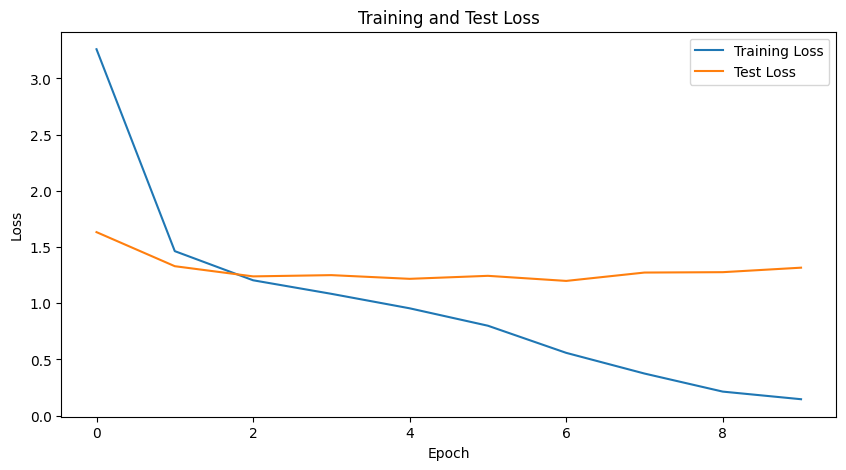

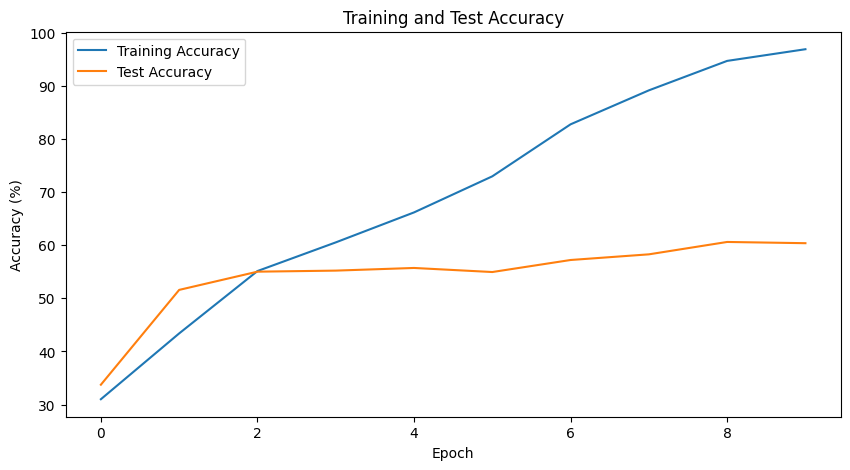

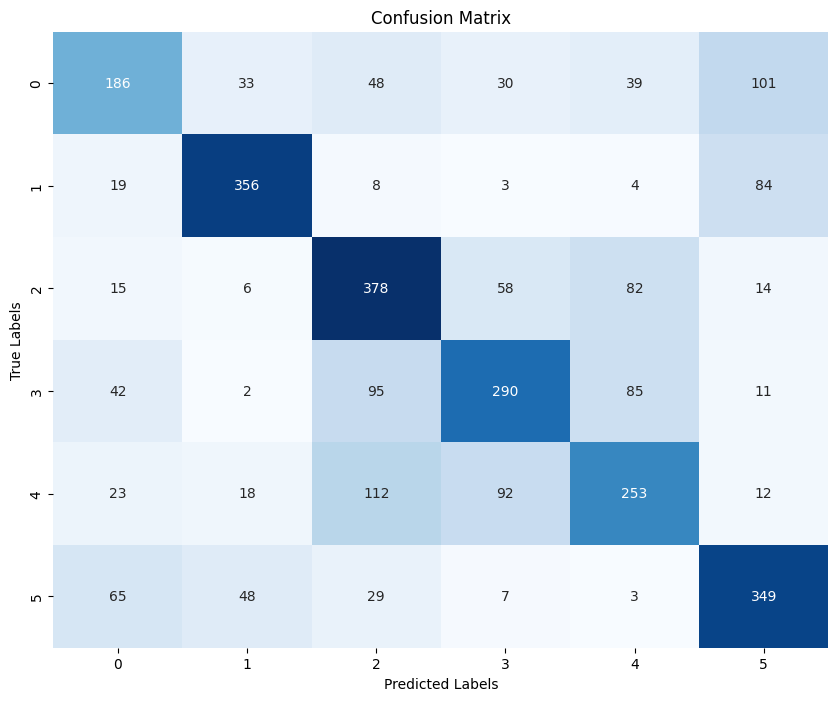

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Function to block a percentage of pixels in an image
def block_pixels(image, percentage):
    # Calculate the number of pixels to block
    num_pixels = int(image.size(1) * image.size(2) * percentage)

    # Generate random indices to block
    indices = random.sample(range(image.size(1) * image.size(2)), num_pixels)
    indices = torch.tensor(indices)

    # Set the blocked pixels to zero
    image[:, indices // image.size(2), indices % image.size(2)] = 0

    return image

# Define the CNN architecture
class CNN(nn.Module):
    def __init__(self, num_classes):
        super(CNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        self.classifier = nn.Linear(32 * 56 * 56, num_classes)

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

# Set device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define data transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define dataset paths
train_data_path = '/content/drive/MyDrive/dataset1/seg_train'
test_data_path = '/content/drive/MyDrive/dataset1/seg_test'

# Load the training dataset
train_dataset = ImageFolder(train_data_path, transform=transform)

# Use only a subset of 2000 images
random.seed(123)
subset_indices = random.sample(range(len(train_dataset)), k=2000)
train_subset = torch.utils.data.Subset(train_dataset, subset_indices)

train_loader = DataLoader(train_subset, batch_size=64, shuffle=True)

# Load the testing dataset
test_dataset = ImageFolder(test_data_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Create an instance of the CNN model
num_classes = len(train_dataset.classes)
model = CNN(num_classes).to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
train_loss_history = []
test_loss_history = []
train_accuracy_history = []
test_accuracy_history = []

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        # Block 15% of the pixels in each image
        for i in range(images.size(0)):
            images[i] = block_pixels(images[i].clone(), 0.15)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_accuracy = 100 * correct / total

    # Evaluation
    model.eval()
    with torch.no_grad():
        test_running_loss = 0.0
        test_correct = 0
        test_total = 0

        for images, labels in test_loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            test_running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            test_total += labels.size(0)
            test_correct += (predicted == labels).sum().item()

        test_loss = test_running_loss / len(test_loader)
        test_accuracy = 100 * test_correct / test_total

    train_loss_history.append(train_loss)
    test_loss_history.append(test_loss)
    train_accuracy_history.append(train_accuracy)
    test_accuracy_history.append(test_accuracy)

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {train_loss:.4f}, Accuracy: {train_accuracy:.2f}%, Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%")

# Plotting the training and test loss
plt.figure(figsize=(10, 5))
plt.plot(train_loss_history, label='Training Loss')
plt.plot(test_loss_history, label='Test Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Test Loss')
plt.legend()
plt.show()

# Plotting the training and test accuracy
plt.figure(figsize=(10, 5))
plt.plot(train_accuracy_history, label='Training Accuracy')
plt.plot(test_accuracy_history, label='Test Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Training and Test Accuracy')
plt.legend()
plt.show()

# Calculate the confusion matrix
model.eval()
all_labels = []
all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)

        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

# Convert the lists to numpy arrays
all_labels = np.array(all_labels)
all_predictions = np.array(all_predictions)

# Create the confusion matrix
cm = confusion_matrix(all_labels, all_predictions)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', cbar=False)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
# Save the trained model
torch.save(model.state_dict(), 'trained_model.pth')


In [ ]:
# Load the saved model
model = CNN(num_classes)
model.load_state_dict(torch.load('trained_model.pth'))
model.eval()


CNN(
  (features): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Linear(in_features=100352, out_features=6, bias=True)
)